# 0. Imports

In [34]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr
import folium
from folium.plugins import HeatMap, HeatMapWithTime

# 1. Loading Data

In [5]:
from google.colab import drive
drive.mount('/content/drive/', force_remount = True)

Mounted at /content/drive/


In [6]:
!cd drive
!ls

drive  sample_data


In [7]:
# Define paths for your data files
sample_data_path = '/content/drive/My Drive/DAT490Team/sample_merged_data.csv'
census_2010_2020_path = '/content/drive/My Drive/DAT490Team/Census2010_2020.csv'
census_2020_2023_path = '/content/drive/My Drive/DAT490Team/Census2020_2023.csv'

# Load datasets
sample_data = pd.read_csv(sample_data_path)
census_2010_2020 = pd.read_csv(census_2010_2020_path)
census_2020_2023 = pd.read_csv(census_2020_2023_path)


Sample Merged Data:
          ID   Source  Severity           Start_Time             End_Time  \
0  A-2047758  Source2         2  2019-06-12 10:10:56  2019-06-12 10:55:58   
1  A-4694324  Source1         2                  NaN                  NaN   
2  A-5006183  Source1         2                  NaN                  NaN   
3  A-4237356  Source1         2  2022-02-21 17:43:04  2022-02-21 19:43:23   
4  A-6690583  Source1         2  2020-12-04 01:46:00  2020-12-04 04:13:09   

   Start_Lat   Start_Lng    End_Lat     End_Lng  Distance(mi)  ...  \
0  30.641211  -91.153481        NaN         NaN         0.000  ...   
1  38.990562  -77.399070  38.990037  -77.398282         0.056  ...   
2  34.661189 -120.492822  34.661189 -120.492442         0.022  ...   
3  43.680592  -92.993317  43.680574  -92.972223         1.054  ...   
4  35.395484 -118.985176  35.395476 -118.985995         0.046  ...   

      State_y Population    Year Month   Day End_Year End_Month End_Day  \
0   Louisiana        

# 2. Data Cleaning

In [36]:
# Display basic dataset information
def display_basic_info(df):
    print("=== Basic Information ===")
    print(df.info())
    print("\n=== First Few Rows ===")
    print(df.head())
    print("\n=== Summary Statistics for Numerical Columns ===")
    print(df.describe())
    print("\n=== Missing Values Per Column ===")
    missing_values = df.isnull().sum()
    print(missing_values[missing_values > 0])
    print("\n=== Number of Duplicated Rows ===")
    print(df.duplicated().sum())
    print("\n=== Unique Values in Categorical Columns ===")
    for col in df.select_dtypes(include='object').columns:
        unique_values = df[col].nunique()
        print(f"Column '{col}' has {unique_values} unique values.")
    print("\n=== Example Unique Values in Key Categorical Columns ===")
    for col in ['Weather_Condition', 'Source', 'Sunrise_Sunset', 'State_x', 'State_y']:
        if col in df.columns:
            print(f"\nColumn: {col}")
            print(df[col].value_counts().head(10))  # Show top 10 unique values

# Call the function to display basic information
display_basic_info(sample_data)

=== Basic Information ===
<class 'pandas.core.frame.DataFrame'>
Index: 462700 entries, 0 to 499999
Data columns (total 57 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   ID                     462700 non-null  object 
 1   Source                 462700 non-null  object 
 2   Severity               462700 non-null  int64  
 3   Start_Time             414537 non-null  object 
 4   End_Time               414537 non-null  object 
 5   Start_Lat              462700 non-null  float64
 6   Start_Lng              462700 non-null  float64
 7   End_Lat                260650 non-null  float64
 8   End_Lng                260650 non-null  float64
 9   Distance(mi)           462700 non-null  float64
 10  Description            462699 non-null  object 
 11  Street                 462034 non-null  object 
 12  City                   462683 non-null  object 
 13  County                 462700 non-null  object 
 14  State_x        

Dataset Sources:
- Full (https://www.kaggle.com/datasets/sobhanmoosavi/us-accidents?resource=download)
- Sampled (https://drive.google.com/file/d/1U3u8QYzLjnEaSurtZfSAS_oh9AT2Mn8X/edit)

In [9]:
# Define the mapping of state abbreviations to full state names, including DC but excluding Alaska and Hawaii
state_to_abbreviation = {
    'Alabama': 'AL', 'Arizona': 'AZ', 'Arkansas': 'AR', 'California': 'CA',
    'Colorado': 'CO', 'Connecticut': 'CT', 'Delaware': 'DE', 'Florida': 'FL',
    'Georgia': 'GA', 'Idaho': 'ID', 'Illinois': 'IL', 'Indiana': 'IN',
    'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA',
    'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI',
    'Minnesota': 'MN', 'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT',
    'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH', 'New Jersey': 'NJ',
    'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND',
    'Ohio': 'OH', 'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA',
    'Rhode Island': 'RI', 'South Carolina': 'SC', 'South Dakota': 'SD',
    'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT',
    'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV', 'Wisconsin': 'WI',
    'Wyoming': 'WY', 'District Of Columbia': 'DC'
}

# Create a reverse mapping of abbreviations to state names
abbreviation_to_state = {v: k for k, v in state_to_abbreviation.items()}

# Step 1: Define a function to align `State_Full` and `State_y` based on `State_x`
def align_state_columns(df, full_col, abbrev_col, y_col):
    """
    Aligns `State_Full` and `State_y` to match `State_x` using the abbreviation mapping.
    """
    # Standardize formats
    df[full_col] = df[full_col].str.title()
    df[abbrev_col] = df[abbrev_col].str.upper()
    df[y_col] = df[y_col].str.title()

    # Replace 'State Not Found' and NaN with None
    df[full_col] = df[full_col].replace(['State Not Found', np.nan], None)

    # Map `State_x` to full state names and update `State_Full` and `State_y`
    df[full_col] = df[abbrev_col].map(abbreviation_to_state)
    df[y_col] = df[full_col]
    return df

# Apply the alignment function to standardize state columns
sample_data = align_state_columns(sample_data, 'State_Full', 'State_x', 'State_y')

# Step 2: Verify the alignment
print("\n=== Preview After Aligning `State_Full` and `State_y` to `State_x` ===")
print(sample_data[['State_Full', 'State_x', 'State_y']].head(20))

# Step 3: Final check for unique states in all columns
print("\n=== Final Unique States Check ===")
print("Unique values in `State_Full`:", sorted(sample_data['State_Full'].unique()))
print("Unique values in `State_x`:", sorted(sample_data['State_x'].unique()))
print("Unique values in `State_y`:", sorted(sample_data['State_y'].unique()))

# Step 4: Check for any mismatches between columns
mismatched_full = sample_data[sample_data['State_Full'] != sample_data['State_x'].map(abbreviation_to_state)]
mismatched_y = sample_data[sample_data['State_y'] != sample_data['State_Full']]

# Display mismatches, if any
print("\n=== Mismatches Between `State_Full` and `State_x` ===")
if not mismatched_full.empty:
    print(mismatched_full[['State_Full', 'State_x', 'State_y']])
else:
    print("No mismatches found between `State_Full` and `State_x`.")

print("\n=== Mismatches Between `State_y` and `State_Full` ===")
if not mismatched_y.empty:
    print(mismatched_y[['State_Full', 'State_x', 'State_y']])
else:
    print("No mismatches found between `State_y` and `State_Full`.")


=== Preview After Aligning `State_Full` and `State_y` to `State_x` ===
       State_Full State_x        State_y
0       Louisiana      LA      Louisiana
1        Virginia      VA       Virginia
2      California      CA     California
3       Minnesota      MN      Minnesota
4      California      CA     California
5   Massachusetts      MA  Massachusetts
6          Oregon      OR         Oregon
7         Florida      FL        Florida
8           Texas      TX          Texas
9         Indiana      IN        Indiana
10        Indiana      IN        Indiana
11        Montana      MT        Montana
12        Alabama      AL        Alabama
13     California      CA     California
14        Arizona      AZ        Arizona
15        Florida      FL        Florida
16       Virginia      VA       Virginia
17          Texas      TX          Texas
18       New York      NY       New York
19        Florida      FL        Florida

=== Final Unique States Check ===
Unique values in `State_Full`: [

In [10]:
# Create and display a summary table for missing values
missing_summary = pd.DataFrame({
    'Missing Values': sample_data.isnull().sum(),
    'Percentage (%)': sample_data.isnull().mean() * 100
})

print("\n=== Missing Values Summary ===")
print(missing_summary)

# Highlight missing values specifically for the Population column
population_missing = missing_summary.loc['Population']
print(f"\n=== Missing Values in `Population` Column ===")
print(f"Count: {population_missing['Missing Values']}")
print(f"Percentage: {population_missing['Percentage (%)']:.2f}%")



=== Missing Values Summary ===
                       Missing Values  Percentage (%)
ID                                  0          0.0000
Source                              0          0.0000
Severity                            0          0.0000
Start_Time                      48163          9.6326
End_Time                        48163          9.6326
Start_Lat                           0          0.0000
Start_Lng                           0          0.0000
End_Lat                        220377         44.0754
End_Lng                        220377         44.0754
Distance(mi)                        0          0.0000
Description                         1          0.0002
Street                            691          0.1382
City                               19          0.0038
County                              0          0.0000
State_x                             0          0.0000
Zipcode                           116          0.0232
Country                             0          0.0

We'll revisit Population down below

Extracting Year from Start_Time or End_Time and creating column for Year, Month, Day, Hour

In [11]:
def process_datetime_column(df, column_name, extract_hour=True):
    # Step 1: Check for missing values before conversion
    missing_before = df[column_name].isnull().sum()
    print(f"Missing values in '{column_name}' before conversion: {missing_before}")

    # Step 2: Ensure the column is in datetime format
    df[column_name] = pd.to_datetime(df[column_name], errors='coerce')

    # Step 3: Check for invalid entries after conversion
    invalid_after = df[column_name].isnull().sum()
    print(f"Invalid or non-parsable values in '{column_name}' after conversion: {invalid_after}")

    # Step 4: Filter out rows with invalid datetime values
    initial_row_count = len(df)
    df = df.dropna(subset=[column_name]).copy()  # Use .copy() to avoid SettingWithCopyWarning
    rows_dropped = initial_row_count - len(df)
    print(f"Rows after dropping invalid '{column_name}': {len(df)} (Dropped: {rows_dropped})")

    # Step 5: Extract 'Year', 'Month', 'Day', and 'Hour' components using .loc
    df.loc[:, f'{column_name}_Year'] = df[column_name].dt.year
    df.loc[:, f'{column_name}_Month'] = df[column_name].dt.month
    df.loc[:, f'{column_name}_Day'] = df[column_name].dt.day
    if extract_hour:
        df.loc[:, f'{column_name}_Hour'] = df[column_name].dt.hour

    return df


In [12]:
# Assuming `sample_data` is already cleaned

# Confirm that no rows with NaT values remain in 'Start_Time' and 'End_Time'
print("\n=== Shape of the dataset after cleaning 'Start_Time' and 'End_Time' ===")
print(sample_data.shape)

# Display the first few rows of the cleaned time data columns
cleaned_time_preview = sample_data[['Start_Time', 'Year', 'Month', 'Day', 'End_Time', 'End_Year', 'End_Month', 'End_Day']].head(10)
print("\n=== Preview of Cleaned Time Data ===")
print(cleaned_time_preview)

# Check for missing values in the relevant columns
missing_values_summary = sample_data[['Start_Time', 'End_Time', 'Year', 'Month', 'Day', 'End_Year', 'End_Month', 'End_Day']].isnull().sum()
print("\n=== Missing Values in Time Columns ===")
print(missing_values_summary)

# Check for unexpected or invalid date values
print("\n=== Check for Unexpected or Invalid Date Values ===")
invalid_dates = sample_data[(sample_data['Year'] <= 0) |
                            (sample_data['Month'] <= 0) |
                            (sample_data['Day'] <= 0) |
                            (sample_data['End_Year'] <= 0) |
                            (sample_data['End_Month'] <= 0) |
                            (sample_data['End_Day'] <= 0)]
if not invalid_dates.empty:
    print("Found rows with invalid date values:")
    print(invalid_dates[['Start_Time', 'Year', 'Month', 'Day', 'End_Time', 'End_Year', 'End_Month', 'End_Day']].head(10))
else:
    print("No invalid date values found.")

# Final confirmation of cleaned data
print("\n=== Preview of Cleaned Time Data After Final Check ===")
print(sample_data[['Start_Time', 'Year', 'Month', 'Day', 'End_Time', 'End_Year', 'End_Month', 'End_Day']].head(10))



=== Shape of the dataset after cleaning 'Start_Time' and 'End_Time' ===
(500000, 57)

=== Preview of Cleaned Time Data ===
            Start_Time    Year  Month   Day             End_Time  End_Year  \
0  2019-06-12 10:10:56  2019.0    6.0  12.0  2019-06-12 10:55:58    2019.0   
1                  NaN     NaN    NaN   NaN                  NaN       NaN   
2                  NaN     NaN    NaN   NaN                  NaN       NaN   
3  2022-02-21 17:43:04  2022.0    2.0  21.0  2022-02-21 19:43:23    2022.0   
4  2020-12-04 01:46:00  2020.0   12.0   4.0  2020-12-04 04:13:09    2020.0   
5  2021-03-29 07:03:58  2021.0    3.0  29.0  2021-03-29 08:51:01    2021.0   
6  2020-01-14 16:49:23  2020.0    1.0  14.0  2020-01-14 20:49:23    2020.0   
7                  NaN     NaN    NaN   NaN                  NaN       NaN   
8  2022-10-12 13:59:30  2022.0   10.0  12.0  2022-10-12 15:33:53    2022.0   
9  2021-10-21 07:39:30  2021.0   10.0  21.0  2021-10-21 09:24:30    2021.0   

   End_Month  End

Exploratory analysis reveals that not every month has complete data. The following is exploration and dropping the year 2016 and 2023

In [13]:
# Group by Year and Month to count the number of accidents for each month
monthly_accident_counts = sample_data.groupby(['Year', 'Month']).size().reset_index(name='Accident_Count')

# Create a pivot table for better visualization (Year-Month Matrix)
monthly_accident_pivot = monthly_accident_counts.pivot(index='Year', columns='Month', values='Accident_Count').fillna(0)

# Display the pivot table with accident counts for each month and year
print("\n=== Year-Month Accident Counts ===")
print(monthly_accident_pivot)

# Calculate the total number of accidents for each month across all years
monthly_totals = monthly_accident_counts.groupby('Month')['Accident_Count'].sum()

# Display total accident counts for each month
print("\n=== Total Number of Accidents by Month (Across All Years) ===")
print(monthly_totals)

# Calculate the average number of accidents per month across all years
monthly_averages = monthly_totals / sample_data['Year'].nunique()
print("\n=== Average Number of Accidents per Month Across All Years ===")
print(monthly_averages)

# Drop rows where the 'Year' is 2016 or 2023
original_shape = sample_data.shape[0]
sample_data = sample_data[~sample_data['Year'].isin([2016, 2023])]

# Calculate the number of rows dropped
rows_dropped = original_shape - sample_data.shape[0]
percentage_dropped = (rows_dropped / original_shape) * 100

# Print the summary of data dropped
print("\n=== Data Dropped Summary ===")
print(f"Original Number of Rows: {original_shape}")
print(f"Number of Rows Dropped: {rows_dropped}")
print(f"Percentage of Data Dropped: {percentage_dropped:.2f}%")

# Confirm the shape after dropping 2016 and 2023 data
print("\n=== Shape of the Dataset After Dropping 2016 and 2023 ===")
print(sample_data.shape)

# Recalculate Year-Month accident counts to confirm the changes
year_month_counts_updated = sample_data.groupby(['Year', 'Month']).size().reset_index(name='Record_Count')
year_month_pivot_updated = year_month_counts_updated.pivot(index='Year', columns='Month', values='Record_Count').fillna(0)

print("\n=== Updated Year-Month Accident Counts ===")
print(year_month_pivot_updated)

# Calculate the new percentage of accident counts for each year
monthly_completeness_updated = (year_month_pivot_updated > 0).sum(axis=1) / 12 * 100

print("\n=== Updated Yearly Completeness (%) ===")
print(monthly_completeness_updated)

# Identify if there are still any incomplete years
incomplete_years_updated = monthly_completeness_updated[monthly_completeness_updated < 100].index.tolist()
print("\n=== Incomplete Years After Dropping 2016 and 2023 ===")
print(incomplete_years_updated)

# Full dataset count
original_row_count = 500000
current_row_count = sample_data.shape[0]

# Calculate the number of rows dropped and the percentage of rows dropped
total_rows_dropped = original_row_count - current_row_count
percentage_dropped = (total_rows_dropped / original_row_count) * 100

# Display the results
print("=== Data Dropped Compared to the Original Dataset ===")
print(f"Original Number of Rows: {original_row_count}")
print(f"Current Number of Rows: {current_row_count}")
print(f"Total Rows Dropped: {total_rows_dropped}")
print(f"Percentage of Data Dropped: {percentage_dropped:.2f}%")



=== Year-Month Accident Counts ===
Month     1.0     2.0     3.0     4.0     5.0     6.0     7.0     8.0   \
Year                                                                     
2016.0     2.0    58.0   378.0  1196.0  1185.0  1941.0  3055.0  3566.0   
2017.0  3586.0  3374.0  3718.0  3164.0  2639.0  2904.0  2744.0  5334.0   
2018.0  4874.0  4679.0  4754.0  4773.0  4939.0  4416.0  4223.0  4875.0   
2019.0  5189.0  4892.0  4375.0  4783.0  4749.0  4234.0  4424.0  4923.0   
2020.0  5909.0  5508.0  5469.0  5738.0  5641.0  6429.0  2297.0  2416.0   
2021.0  9014.0  9398.0  5374.0  5507.0  6111.0  7658.0  6613.0  7062.0   
2022.0  6631.0  7836.0  6729.0  9234.0  7455.0  6153.0  6895.0  7098.0   
2023.0  7015.0  2343.0  1279.0     0.0     0.0     0.0     0.0     0.0   

Month     9.0     10.0     11.0     12.0  
Year                                      
2016.0  3603.0  3570.0   4281.0   3828.0  
2017.0  5043.0  4822.0   4571.0   4553.0  
2018.0  4784.0  5472.0   5270.0   4519.0  
2019.0  

Dropped data for the Years 2016 and 2023 as they contain incomplete data from our merged_sample_data.csv

Introducing expenditures dataframe and cleaning it. Merging with merged_sample_data.csv

In [14]:
import pandas as pd

# Step 1: Create expenditures DataFrame
data_dict = {
    'State': [
        'Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California', 'Colorado', 'Connecticut',
        'District of Columbia', 'Delaware', 'Florida', 'Georgia', 'Hawaii', 'Idaho',
        'Illinois', 'Indiana', 'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine',
        'Maryland', 'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi', 'Missouri',
        'Montana', 'Nebraska', 'Nevada', 'New Hampshire', 'New Jersey', 'New Mexico',
        'New York', 'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon',
        'Pennsylvania', 'Rhode Island', 'South Carolina', 'South Dakota', 'Tennessee',
        'Texas', 'Utah', 'Vermont', 'Virginia', 'Washington', 'West Virginia', 'Wisconsin',
        'Wyoming'
    ],
    '2017': [2533, 1413, 2561, 2076, 15626, 3269, 2277, 454, 840, 11271, 4328, 613, 884, 9347, 2509,
             2798, 1927, 2355, 2277, 988, 3371, 3829, 4267, 4812, 1732, 2359, 839, 1564, 2030, 757,
             4848, 914, 12220, 4867, 1735, 6052, 2582, 2122, 9786, 473, 2278, 1003, 2250, 15492, 1832,
             623, 4931, 4393, 1228, 5496, 675],
    '2018': [2895, 1578, 2668, 2020, 15892, 3335, 2153, 601, 762, 11144, 4401, 878, 1036, 7848, 2612,
             2931, 1698, 2268, 2135, 980, 3706, 3460, 4670, 4841, 1738, 2558, 865, 1626, 2099, 761,
             5034, 959, 14802, 5736, 1411, 6019, 2599, 2107, 10806, 547, 2347, 963, 2492, 15374, 2031,
             666, 5556, 4430, 1306, 4728, 679],
    '2019': [2653, 1294, 2869, 1712, 20046, 3188, 2114, 611, 820, 12132, 4378, 821, 1230, 7479, 3397,
             3038, 1640, 2274, 2174, 957, 3727, 3221, 5202, 5006, 1750, 2583, 971, 1698, 1959, 755,
             4654, 1033, 14092, 6578, 1249, 5998, 2790, 2311, 11423, 659, 2243, 974, 2729, 23824, 2189,
             674, 5899, 4787, 1539, 4722, 688],
    '2020': [2652, 1357, 3051, 1836, 22759, 3452, 2122, 661, 705, 12242, 5052, 778, 1437, 8550, 3653,
             3314, 1807, 2380, 2169, 1198, 3477, 3333, 5774, 5436, 1755, 2766, 1043, 1971, 2357, 780,
             4392, 1128, 11881, 5933, 1223, 6413, 2954, 2469, 11054, 730, 2395, 1173, 2893, 19586, 2589,
             708, 5923, 4960, 1847, 4790, 788],
    '2021': [2552, 1303, 2940, 2196, 23767, 3602, 2158, 671, 804, 12130, 5159, 974, 1299, 8986, 3828,
             3148, 2013, 2260, 2368, 1120, 3016, 3408, 5855, 5665, 1867, 2877, 1010, 1884, 2104, 796,
             4339, 1264, 12094, 5265, 1354, 6016, 3059, 2683, 10676, 680, 2208, 1213, 2731, 19486, 2531,
             736, 6895, 4935, 1748, 4020, 742]
}

expenditures_df = pd.DataFrame(data_dict)

# Step 2: Reshape the DataFrame
expenditures_long = pd.melt(expenditures_df, id_vars=['State'], var_name='Year', value_name='Expenditures(M)')

# Convert Year to integer
expenditures_long['Year'] = expenditures_long['Year'].astype(int)

# Step 3: Drop Alaska and Hawaii
expenditures_long = expenditures_long[~expenditures_long['State'].isin(['Alaska', 'Hawaii'])]

# Optional: Rename 'State' to 'State_Full' for consistency
expenditures_long.rename(columns={'State': 'State_Full'}, inplace=True)

# Display the reshaped DataFrame
print(expenditures_long.head())

# Step 1: Check the columns of both DataFrames
print("Columns in expenditures_long:")
print(expenditures_long.columns)
print("\nColumns in sample_data:")
print(sample_data.columns)

# Step 2: Merge the DataFrames on 'State_Full' and 'Year'
merged_df = pd.merge(expenditures_long, sample_data, on=['State_Full', 'Year'], how='inner')

# Step 3: Display the merged DataFrame
print("Merged DataFrame:")
print(merged_df.head(20))

# Check for duplicates
duplicates = merged_df.duplicated().sum()
print(f"Number of duplicate rows in the merged DataFrame: {duplicates}")



   State_Full  Year  Expenditures(M)
0     Alabama  2017             2533
2     Arizona  2017             2561
3    Arkansas  2017             2076
4  California  2017            15626
5    Colorado  2017             3269
Columns in expenditures_long:
Index(['State_Full', 'Year', 'Expenditures(M)'], dtype='object')

Columns in sample_data:
Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State_x', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_T

In [15]:
# # Step 1: Check the columns of both DataFrames
# print("Columns in expenditures_long:")
# print(expenditures_long.columns)
# print("\nColumns in data_cleaned:")
# print(data_cleaned.columns)

# # Step 2: Merge the DataFrames on 'State_Full' and 'Year'
# merged_df = pd.merge(expenditures_long, data_cleaned, on=['State_Full', 'Year'], how='inner')

# # Step 3: Display the merged DataFrame
# print("Merged DataFrame:")
# print(merged_df.head(20))


One last thing to explore and clean is the Population column

In [16]:
# Check for missing values in the 'Population' column of the merged_df DataFrame
missing_population = merged_df['Population'].isnull().sum()
population_stats = merged_df['Population'].describe()

print(f"Number of missing values in 'Population': {missing_population}")
print("\nPopulation Statistics:")
print(population_stats)


Number of missing values in 'Population': 17559

Population Statistics:
count    3.146380e+05
mean     1.812661e+06
std      2.520679e+06
min      6.500000e+01
25%      3.833080e+05
50%      9.143980e+05
75%      2.015501e+06
max      9.992813e+06
Name: Population, dtype: float64


In [17]:
# Check for missing values in the 'Population' column of the merged_df DataFrame
missing_population = merged_df['Population'].isnull().sum()
population_stats = merged_df['Population'].describe()

print(f"Number of missing values in 'Population': {missing_population}")
print("\nPopulation Statistics:")
print(population_stats)

# Check for missing population values grouped by State_Full and Year to see which states and years have missing data
missing_population_by_state_year = (
    merged_df[merged_df['Population'].isnull()]
    .groupby(['State_Full', 'Year'])
    .size()
    .reset_index(name='Missing Records')
)

# Display states and years with missing population data
print("\n=== States and Years with Missing Population Data ===")
for state, group in missing_population_by_state_year.groupby('State_Full'):
    print(f"{state}:")
    for _, row in group.iterrows():
        print(f"  Year: {row['Year']}, Missing Records: {row['Missing Records']}")


# Display the total number of rows in merged_df
print(f"\nTotal rows in `merged_df`: {len(merged_df)}")


Number of missing values in 'Population': 17559

Population Statistics:
count    3.146380e+05
mean     1.812661e+06
std      2.520679e+06
min      6.500000e+01
25%      3.833080e+05
50%      9.143980e+05
75%      2.015501e+06
max      9.992813e+06
Name: Population, dtype: float64

=== States and Years with Missing Population Data ===
Alabama:
  Year: 2021, Missing Records: 5
Arkansas:
  Year: 2021, Missing Records: 4
Connecticut:
  Year: 2017, Missing Records: 431
  Year: 2018, Missing Records: 409
  Year: 2019, Missing Records: 366
  Year: 2020, Missing Records: 639
  Year: 2021, Missing Records: 880
Florida:
  Year: 2017, Missing Records: 8
  Year: 2018, Missing Records: 1
  Year: 2020, Missing Records: 5
  Year: 2021, Missing Records: 29
Georgia:
  Year: 2018, Missing Records: 6
  Year: 2019, Missing Records: 12
  Year: 2020, Missing Records: 27
  Year: 2021, Missing Records: 9
Illinois:
  Year: 2017, Missing Records: 1
  Year: 2021, Missing Records: 2
Indiana:
  Year: 2017, Missing

Let's merge new Census data to our merged_df dataframe to overwrite the missing data and be more accurate.





In [18]:
import pandas as pd

# Define the list of expected states
expected_states = [
    'Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California', 'Colorado', 'Connecticut',
    'District of Columbia', 'Delaware', 'Florida', 'Georgia', 'Hawaii', 'Idaho',
    'Illinois', 'Indiana', 'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine',
    'Maryland', 'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi', 'Missouri',
    'Montana', 'Nebraska', 'Nevada', 'New Hampshire', 'New Jersey', 'New Mexico',
    'New York', 'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon',
    'Pennsylvania', 'Rhode Island', 'South Carolina', 'South Dakota', 'Tennessee',
    'Texas', 'Utah', 'Vermont', 'Virginia', 'Washington', 'West Virginia', 'Wisconsin',
    'Wyoming'
]

# Step 1: Prepare and Filter the Census Data
census_2010_2020_cleaned = census_2010_2020[['NAME', 'POPESTIMATE2017', 'POPESTIMATE2018', 'POPESTIMATE2019', 'POPESTIMATE2020']].copy()
census_2010_2020_cleaned.rename(columns={
    'NAME': 'State_Full',
    'POPESTIMATE2017': 'Population_2017',
    'POPESTIMATE2018': 'Population_2018',
    'POPESTIMATE2019': 'Population_2019',
    'POPESTIMATE2020': 'Population_2020'
}, inplace=True)
census_2010_2020_cleaned = census_2010_2020_cleaned[census_2010_2020_cleaned['State_Full'].isin(expected_states)]

census_2020_2023_cleaned = census_2020_2023[['NAME', 'POPESTIMATE2021', 'POPESTIMATE2022', 'POPESTIMATE2023']].copy()
census_2020_2023_cleaned.rename(columns={
    'NAME': 'State_Full',
    'POPESTIMATE2021': 'Population_2021',
    'POPESTIMATE2022': 'Population_2022',
    'POPESTIMATE2023': 'Population_2023'
}, inplace=True)
census_2020_2023_cleaned = census_2020_2023_cleaned[census_2020_2023_cleaned['State_Full'].isin(expected_states)]

# Step 2: Transform the Census Data to Long Format
census_long_2010_2020 = pd.melt(census_2010_2020_cleaned, id_vars=['State_Full'],
                                value_vars=['Population_2017', 'Population_2018', 'Population_2019', 'Population_2020'],
                                var_name='Year', value_name='Population')

census_long_2020_2023 = pd.melt(census_2020_2023_cleaned, id_vars=['State_Full'],
                                value_vars=['Population_2021', 'Population_2022', 'Population_2023'],
                                var_name='Year', value_name='Population')

census_long = pd.concat([census_long_2010_2020, census_long_2020_2023])
census_long['Year'] = census_long['Year'].str.extract('(\d+)').astype(int)

# Step 3: Ensure Consistent State Name Formats Before Merging
merged_df['State_Full'] = merged_df['State_Full'].str.strip().str.title()
census_long['State_Full'] = census_long['State_Full'].str.strip().str.title()

# Step 4: Merge `merged_df` with `census_long` using `State_Full` and `Year` as keys (preserve all `merged_df` rows)
merged_df_updated = pd.merge(merged_df, census_long, on=['State_Full', 'Year'], how='left', suffixes=('', '_census'))

# Step 5: Update Population Column
merged_df_updated['Population'] = merged_df_updated['Population'].combine_first(merged_df_updated['Population_census'])

# Step 6: Drop the extra 'Population_census' column
merged_df_updated.drop(columns=['Population_census'], inplace=True)

# Step 7: Display Results
# Total rows in original and updated DataFrames
print("Total rows in `merged_df`:", len(merged_df))
print("Total rows in `merged_df_updated` (after merge):", len(merged_df_updated))

# Count rows with missing population data
missing_population_count = merged_df_updated['Population'].isna().sum()
print(f"Total rows with missing population data: {missing_population_count}")

# Display rows with missing population data
print("\n=== Rows with Missing Population Data ===")
print(merged_df_updated[merged_df_updated['Population'].isna()].head(10))

# Display the unique state-year combinations in the final cleaned DataFrame
state_year_summary = merged_df_updated.groupby('State_Full')['Year'].unique().reset_index()
print("\nSummary of States and the Years Represented in the Data:")
for _, row in state_year_summary.iterrows():
    print(f"State: {row['State_Full']}, Years: {list(row['Year'])}")


Total rows in `merged_df`: 332197
Total rows in `merged_df_updated` (after merge): 332197
Total rows with missing population data: 0

=== Rows with Missing Population Data ===
Empty DataFrame
Columns: [State_Full, Year, Expenditures(M), ID, Source, Severity, Start_Time, End_Time, Start_Lat, Start_Lng, End_Lat, End_Lng, Distance(mi), Description, Street, City, County, State_x, Zipcode, Country, Timezone, Airport_Code, Weather_Timestamp, Temperature(F), Wind_Chill(F), Humidity(%), Pressure(in), Visibility(mi), Wind_Direction, Wind_Speed(mph), Precipitation(in), Weather_Condition, Amenity, Bump, Crossing, Give_Way, Junction, No_Exit, Railway, Roundabout, Station, Stop, Traffic_Calming, Traffic_Signal, Turning_Loop, Sunrise_Sunset, Civil_Twilight, Nautical_Twilight, Astronomical_Twilight, State_y, Population, Month, Day, End_Year, End_Month, End_Day, State_Full_census, State_Full_census.1]
Index: []

[0 rows x 58 columns]

Summary of States and the Years Represented in the Data:
State: Ala

# 3. EDA

## Visualizations

=== Overall State Distribution ===
State_Full
California        72246
Florida           34115
Texas             26498
South Carolina    18051
North Carolina    15688
New York          14064
Pennsylvania      11489
Virginia          11479
Oregon             8838
Minnesota          8755
Illinois           7915
Tennessee          7754
Arizona            7750
Georgia            7316
Michigan           7166
Louisiana          7062
Maryland           5733
New Jersey         5354
Washington         5176
Alabama            5118
Ohio               4937
Utah               4840
Oklahoma           4654
Colorado           4163
Missouri           3234
Massachusetts      3232
Indiana            3087
Connecticut        2725
Kentucky           1851
Wisconsin          1510
Nebraska           1383
Iowa               1221
Nevada              917
Rhode Island        896
Kansas              797
Arkansas            718
Montana             705
Mississippi         689
Delaware            656
New Hampshire     

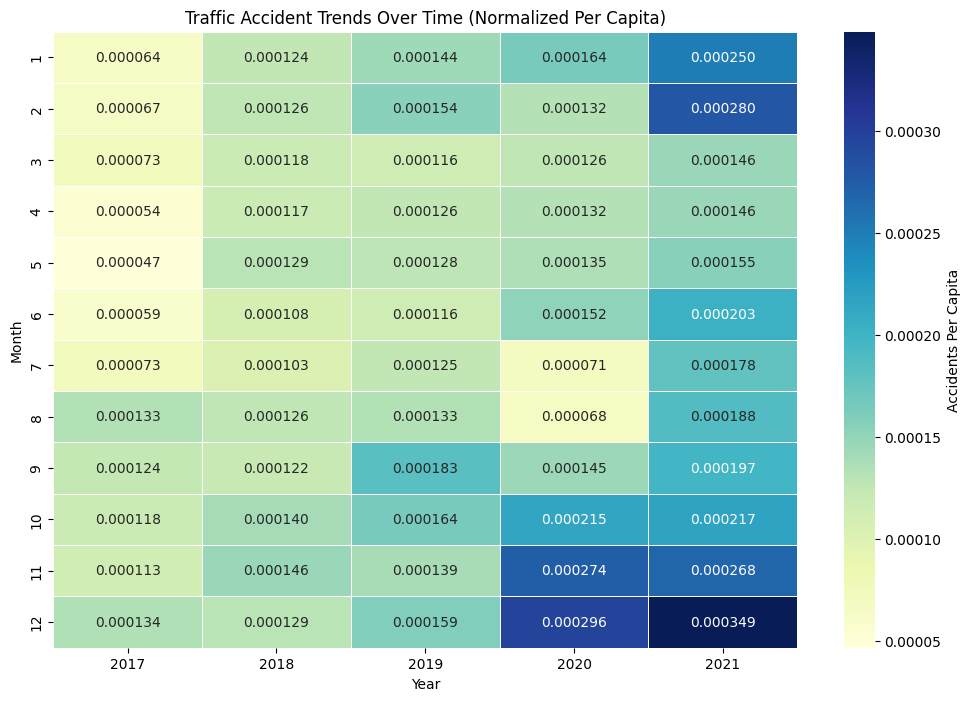

<Axes: xlabel='Year', ylabel='Month'>

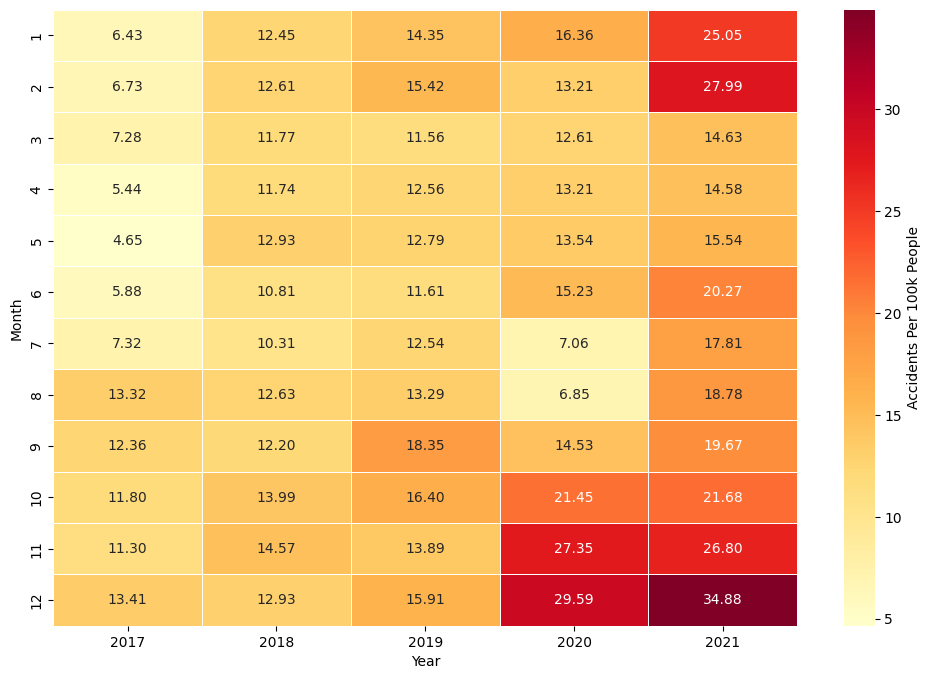

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Overall State Distribution using Full State names from `merged_df_updated`
overall_state_distribution = merged_df_updated['State_Full'].value_counts()
print("=== Overall State Distribution ===")
print(overall_state_distribution)

# Yearly State Distribution using Full State names from `merged_df_updated`
yearly_state_distribution = merged_df_updated.groupby(['Year', 'State_Full']).size().unstack(fill_value=0)
print("\n=== Yearly State Distribution ===")
print(yearly_state_distribution)

# Drop rows with missing Year or Month values
merged_df_updated.dropna(subset=['Year', 'Month'], inplace=True)

# Create 'year_month' Column
merged_df_updated['year_month'] = (
    merged_df_updated['Year'].astype(int).astype(str) + '-' +
    merged_df_updated['Month'].astype(int).astype(str).str.zfill(2)
)

# Group Data by 'year_month' and 'State_Full' to Count Accidents and Calculate Mean Population
monthly_trends_per_capita = merged_df_updated.groupby(['year_month', 'State_Full']).agg({
    'ID': 'count',
    'Population': 'mean'
}).reset_index()

# Rename Columns for Readability
monthly_trends_per_capita.rename(columns={
    'ID': 'total_accidents',
    'Population': 'mean_population'
}, inplace=True)

# Calculate Accidents Per Capita and Per 100,000 and Per 1 Million People
monthly_trends_per_capita['accidents_per_capita'] = (
    monthly_trends_per_capita['total_accidents'] / (monthly_trends_per_capita['mean_population'] + 1e-6)
)
monthly_trends_per_capita['accidents_per_100k'] = monthly_trends_per_capita['accidents_per_capita'] * 100000
monthly_trends_per_capita['accidents_per_million'] = monthly_trends_per_capita['accidents_per_capita'] * 1000000

# Display the DataFrame
print("=== Monthly Trends Per Capita DataFrame ===")
print(monthly_trends_per_capita.head(10))

# Ensure 'Year' and 'Month' columns are correctly formatted in the DataFrame
monthly_trends_per_capita['Year'] = monthly_trends_per_capita['year_month'].str[:4].astype(int)
monthly_trends_per_capita['Month'] = monthly_trends_per_capita['year_month'].str[5:7].astype(int)

# Step 1: Create a Pivot Table for Month and Year View (for Heatmap)
simplified_heatmap_data = monthly_trends_per_capita.pivot_table(
    index='Month',  # Rows: Month
    columns='Year',  # Columns: Year
    values='accidents_per_capita',  # Value: Normalized per capita accident rates
    aggfunc='mean'
)

# Step 2: Plot the Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(
    simplified_heatmap_data,
    cmap='YlGnBu',
    annot=True,  # Add annotation for each cell value
    fmt=".6f",  # Format values to show up to 6 decimal places
    linewidths=0.5,  # Set cell border width for readability
    cbar_kws={'label': 'Accidents Per Capita'}  # Set color bar label
)

# Step 3: Customize Labels and Titles
plt.title('Traffic Accident Trends Over Time (Normalized Per Capita)')
plt.xlabel('Year')
plt.ylabel('Month')
plt.show()

# Second Heatmap: Accidents Per 100k People
second_heatmap_data = monthly_trends_per_capita.pivot_table(
    index='Month',
    columns='Year',
    values='accidents_per_100k',
    aggfunc='mean'
)

plt.figure(figsize=(12, 8))
sns.heatmap(
    second_heatmap_data,
    cmap='YlOrRd',
    annot=True,  # Add annotation for each cell value
    fmt=".2f",  # Format values to show up to 2 decimal places
    linewidths=0.5,  # Set cell border width for readability
    cbar_kws={'label': 'Accidents Per 100k People'}  # Set color bar label
)

# Customize Labels


The heatmap reveals a temporal pattern in traffic accident trends per capita across different months and years. Notably, there are discernible peaks in accidents during certain months, such as August and December, indicating potential seasonal factors influencing traffic safety. The sharp increase in accidents per capita during 2020 is particularly striking and may correlate with changes in traffic dynamics during the early stages of the COVID-19 pandemic. This trend stabilizes in subsequent years, suggesting a return to pre-pandemic patterns.

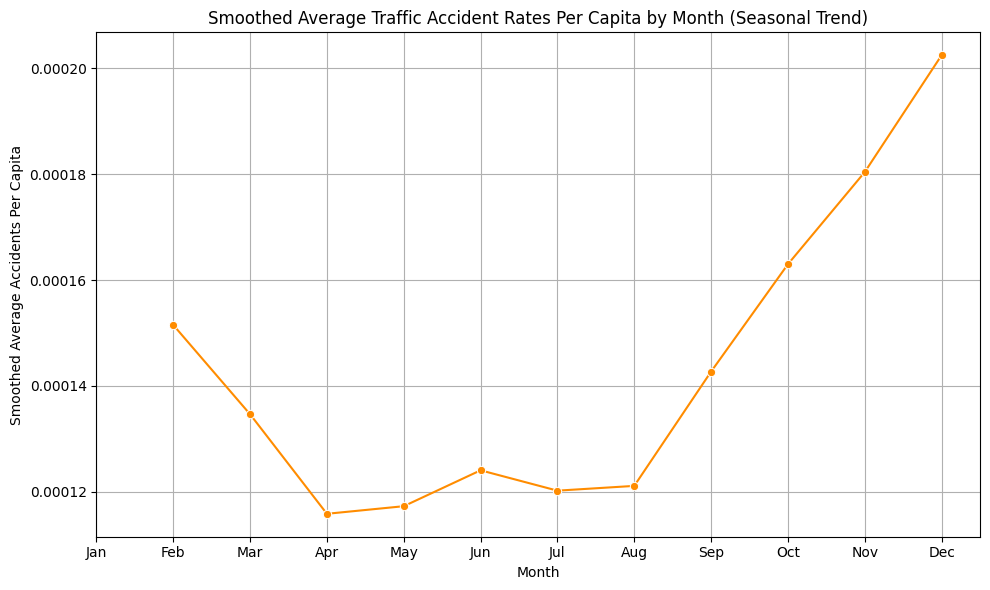

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Aggregate Accident Data by Month Across All Years using `monthly_trends_per_capita`
monthly_seasonal_trends = monthly_trends_per_capita.groupby('Month')['accidents_per_capita'].mean().reset_index()

# Step 2: Apply a Rolling Mean to Smooth the Data
monthly_seasonal_trends['smoothed_accidents'] = monthly_seasonal_trends['accidents_per_capita'].rolling(window=2, center=True).mean()

# Step 3: Create the Smoothed Line Plot for Seasonal Trends
plt.figure(figsize=(10, 6))
sns.lineplot(x='Month', y='smoothed_accidents', data=monthly_seasonal_trends, marker='o', color='darkorange')
plt.title('Smoothed Average Traffic Accident Rates Per Capita by Month (Seasonal Trend)')
plt.xlabel('Month')
plt.ylabel('Smoothed Average Accidents Per Capita')
plt.xticks(ticks=range(1, 13), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.tight_layout()
plt.show()


The smoothed chart reveals a distinct seasonal trend, showing lower traffic accident rates from April through July and a marked increase beginning in August, peaking sharply in December. This pattern likely reflects safer driving conditions in summer and increased travel and hazardous conditions in late fall and winter. The pronounced rise during October through December coincides with periods of heavy holiday traffic and adverse weather, suggesting these months are high-risk for traffic incidents.
Implications for Traffic Safety:

Targeted safety interventions—such as public awareness campaigns and heightened enforcement—should be focused during these high-risk months. Strategically deploying resources during these periods will likely be more effective than uniform measures throughout the year, helping to mitigate the increased risk associated with holiday travel and winter driving conditions. (citation)

In [21]:
import folium
from folium.plugins import HeatMap, HeatMapWithTime
import pandas as pd
from IPython.display import display

# Step 1: Extract the Hour from 'Start_Time' and add to merged_df_updated
merged_df_updated['Start_Time'] = pd.to_datetime(merged_df_updated['Start_Time'], errors='coerce')
merged_df_updated['Hour'] = merged_df_updated['Start_Time'].dt.hour

# ================================================
# TIME-BASED ACCIDENT HEATMAP (Using Start Coordinates)
# ================================================
# Create a new DataFrame for the time-based heatmap analysis
time_based_data = merged_df_updated[['Hour', 'Start_Lat', 'Start_Lng']].dropna()

# Group by hour to get frequency of accidents for each hour
time_grouped_data = [
    time_based_data[time_based_data['Hour'] == h][['Start_Lat', 'Start_Lng']].values.tolist()
    for h in sorted(time_based_data['Hour'].unique())
]

# Create a Folium map for Time-Based Accident Heatmap
time_heatmap = folium.Map(location=[37.0902, -95.7129], zoom_start=5, tiles='cartodbpositron')
HeatMapWithTime(time_grouped_data, index=[f'{h}:00' for h in sorted(time_based_data['Hour'].unique())], radius=6).add_to(time_heatmap)

# Display the time-based heatmap
display(time_heatmap)



In [22]:
# ================================================
# LOCATION-BASED ACCIDENT HEATMAP (Using Both Start and End Coordinates)
# ================================================
# Create a new DataFrame combining both start and end coordinates for location-based analysis
location_based_data = pd.concat([
    merged_df_updated[['Start_Lat', 'Start_Lng']].rename(columns={'Start_Lat': 'Latitude', 'Start_Lng': 'Longitude'}),
    merged_df_updated[['End_Lat', 'End_Lng']].rename(columns={'End_Lat': 'Latitude', 'End_Lng': 'Longitude'})
], ignore_index=True).dropna()

# Create a Folium map for Location-Based Accident Heatmap
location_heatmap = folium.Map(location=[37.0902, -95.7129], zoom_start=5, tiles='cartodbpositron')

# Add a heatmap layer using the combined coordinates
HeatMap(data=location_based_data[['Latitude', 'Longitude']].values, radius=8, max_zoom=13).add_to(location_heatmap)

# Display the location-based heatmap
display(location_heatmap)


In [23]:
print("Total rows in `merged_df_updated`:", len(merged_df_updated))
# Check for renamed columns in the DataFrame history if available

Total rows in `merged_df_updated`: 332197


Columns in merged_df_updated:
Index(['State_Full', 'Year', 'Expenditures(M)', 'ID', 'Source', 'Severity',
       'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng', 'End_Lat',
       'End_Lng', 'Distance(mi)', 'Description', 'Street', 'City', 'County',
       'State_x', 'Zipcode', 'Country', 'Timezone', 'Airport_Code',
       'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)',
       'Pressure(in)', 'Visibility(mi)', 'Wind_Direction', 'Wind_Speed(mph)',
       'Precipitation(in)', 'Weather_Condition', 'Amenity', 'Bump', 'Crossing',
       'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station',
       'Stop', 'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop',
       'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight', 'State_y', 'Population', 'Month', 'Day',
       'End_Year', 'End_Month', 'End_Day', 'State_Full_census',
       'State_Full_census.1', 'year_month', 'Hour'],
      dtype='object')


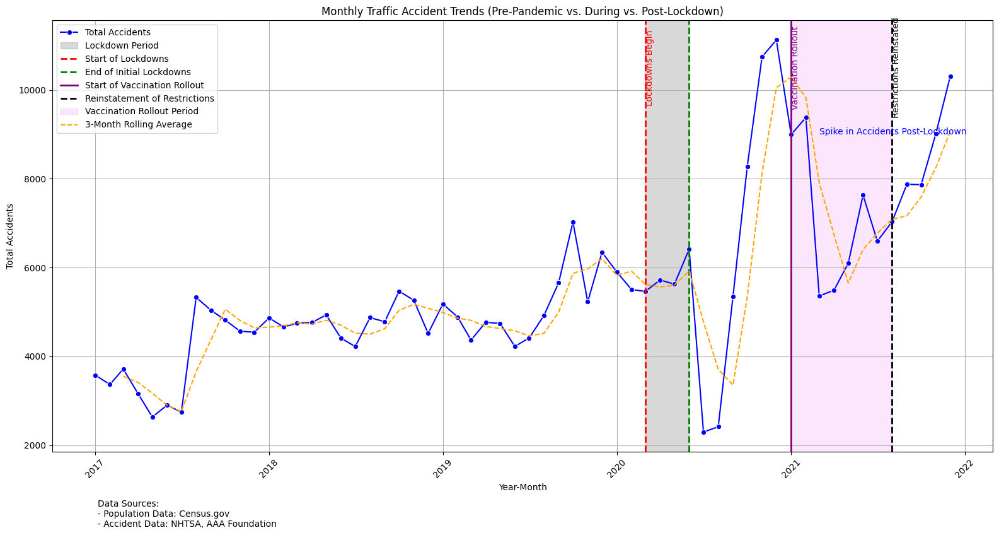

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Verify column names
print("Columns in merged_df_updated:")
print(merged_df_updated.columns)

# If 'Start_Time' exists in a slightly different form, rename it appropriately
if 'start_time' in merged_df_updated.columns:
    merged_df_updated.rename(columns={'start_time': 'Start_Time'}, inplace=True)
elif 'Start Time' in merged_df_updated.columns:
    merged_df_updated.rename(columns={'Start Time': 'Start_Time'}, inplace=True)

# Step 2: Check if 'Start_Time' column is available now
if 'Start_Time' in merged_df_updated.columns:
    # Convert 'Start_Time' to datetime and create a 'Year-Month' column
    merged_df_updated['Start_Time'] = pd.to_datetime(merged_df_updated['Start_Time'])
    merged_df_updated['Year-Month'] = merged_df_updated['Start_Time'].dt.to_period('M')

    # Step 3: Aggregate accident counts by year-month
    monthly_accident_counts = merged_df_updated.groupby('Year-Month').size().reset_index(name='Total_Accidents')

    # Step 4: Convert 'Year-Month' back to datetime for plotting
    monthly_accident_counts['Year-Month'] = monthly_accident_counts['Year-Month'].dt.to_timestamp()

    # Step 5: Create the line plot for accident trends
    plt.figure(figsize=(16, 8))
    sns.lineplot(x='Year-Month', y='Total_Accidents', data=monthly_accident_counts, marker='o', color='blue', label='Total Accidents')

    # Step 6: Add vertical lines for the start and end of lockdowns, vaccination rollout, and reinstatement of restrictions
    plt.axvspan(pd.Timestamp('2020-03-01'), pd.Timestamp('2020-06-01'), color='grey', alpha=0.3, label='Lockdown Period')
    plt.axvline(pd.Timestamp('2020-03-01'), color='red', linestyle='--', linewidth=2, label='Start of Lockdowns')
    plt.axvline(pd.Timestamp('2020-06-01'), color='green', linestyle='--', linewidth=2, label='End of Initial Lockdowns')
    plt.axvline(pd.Timestamp('2021-01-01'), color='purple', linestyle='-', linewidth=2, label='Start of Vaccination Rollout')
    plt.axvline(pd.Timestamp('2021-08-01'), color='black', linestyle='--', linewidth=2, label='Reinstatement of Restrictions')
    plt.axvspan(pd.Timestamp('2021-01-01'), pd.Timestamp('2021-08-01'), color='violet', alpha=0.2, label='Vaccination Rollout Period')

    # Step 7: Add rolling average and annotate peaks and important events
    monthly_accident_counts['Rolling_Average'] = monthly_accident_counts['Total_Accidents'].rolling(window=3).mean()
    sns.lineplot(x='Year-Month', y='Rolling_Average', data=monthly_accident_counts, linestyle='--', color='orange', label='3-Month Rolling Average')
    plt.text(pd.Timestamp('2020-03-01'), 10500, 'Lockdowns Begin', rotation=90, verticalalignment='center', color='red')
    plt.text(pd.Timestamp('2021-01-01'), 10500, 'Vaccination Rollout', rotation=90, verticalalignment='center', color='purple')
    plt.text(pd.Timestamp('2021-08-01'), 10500, 'Restrictions Reinstated', rotation=90, verticalalignment='center', color='black')
    plt.text(pd.Timestamp('2021-03-01'), 9000, 'Spike in Accidents Post-Lockdown', color='blue')

    # Step 8: Customize the plot
    plt.title('Monthly Traffic Accident Trends (Pre-Pandemic vs. During vs. Post-Lockdown)')
    plt.xlabel('Year-Month')
    plt.ylabel('Total Accidents')
    plt.xticks(rotation=45)
    plt.legend(loc='upper left')
    plt.grid(True)
    plt.tight_layout()

    # Step 9: Add data source information
    plt.figtext(0.1, -0.05, "Data Sources:\n- Population Data: Census.gov\n- Accident Data: NHTSA, AAA Foundation", fontsize=10, ha='left')

    # Show the plot
    plt.show()
else:
    print("Column 'Start_Time' not found in the dataframe. Please verify the correct column name.")

<ipython-input-25-54bedca5393e>:12: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_accidents = merged_df_updated['ID'].resample('M').count()


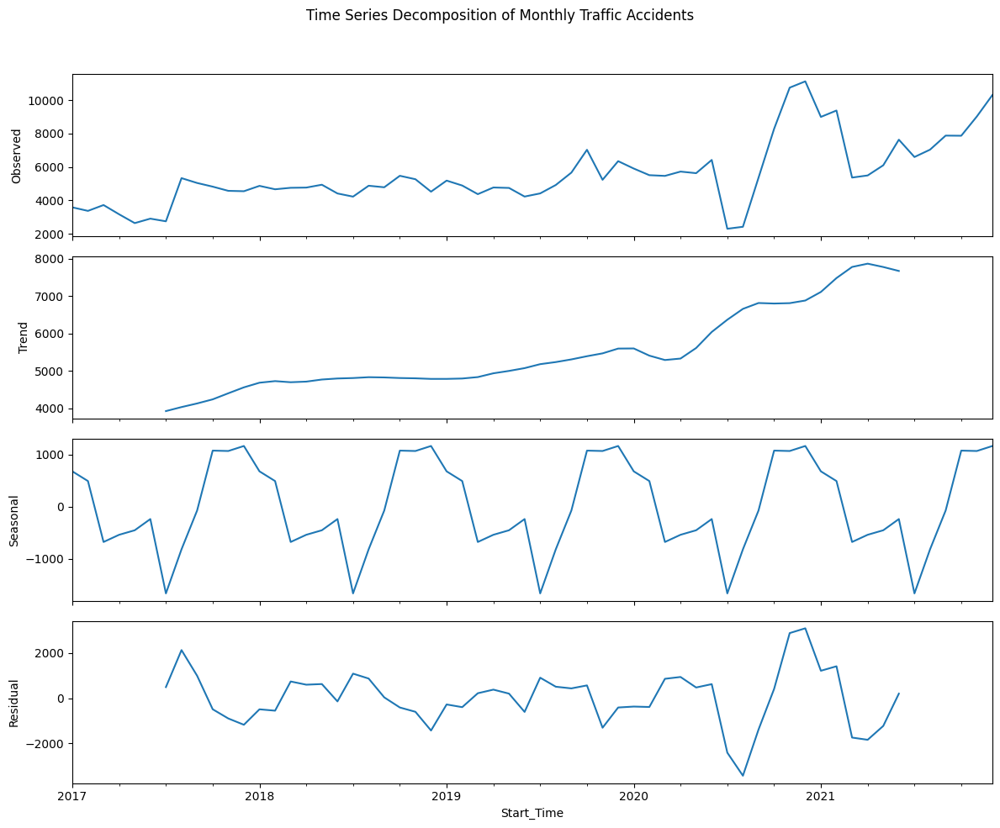

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Step 1: Create a time-series index based on the 'Start_Time' column
# Assuming merged_df_updated has a 'Start_Time' column formatted as datetime
merged_df_updated['Start_Time'] = pd.to_datetime(merged_df_updated['Start_Time'], errors='coerce')
merged_df_updated.dropna(subset=['Start_Time'], inplace=True)
merged_df_updated.set_index('Start_Time', inplace=True)

# Step 2: Aggregate monthly accident counts using the 'M' frequency for Month-Start
monthly_accidents = merged_df_updated['ID'].resample('M').count()

# Step 3: Apply Time-Series Decomposition
# Ensure there is enough data for decomposition
if len(monthly_accidents) > 12:
    decomposition_result = seasonal_decompose(monthly_accidents, model='additive')

    # Step 4: Plot the Decomposed Components
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(12, 10), sharex=True)
    decomposition_result.observed.plot(ax=ax1, legend=False)
    ax1.set_ylabel('Observed')
    decomposition_result.trend.plot(ax=ax2, legend=False)
    ax2.set_ylabel('Trend')
    decomposition_result.seasonal.plot(ax=ax3, legend=False)
    ax3.set_ylabel('Seasonal')
    decomposition_result.resid.plot(ax=ax4, legend=False)
    ax4.set_ylabel('Residual')
    plt.suptitle('Time Series Decomposition of Monthly Traffic Accidents')
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
else:
    print("Not enough data points for seasonal decomposition. Need at least 12 data points.")

# **two fold increase??**

Impact of COVID-19 Pandemic (2020-2021)

Hypothesis: The COVID-19 pandemic led to major disruptions in road usage. Initially, accidents decreased due to lockdowns and fewer vehicles on the road. However, this was followed by a spike in risky driving behavior (speeding, reckless driving) when lockdowns eased.

Compare accident trends for 2020 and 2021 to pre-pandemic years (2017-2019). Is there a significant difference in accident severity or frequency post-lockdown?
    
Visualization: Line chart and annotate specific months when major lockdowns or policy changes occurred to highlight pandemic-related impacts.

/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When 

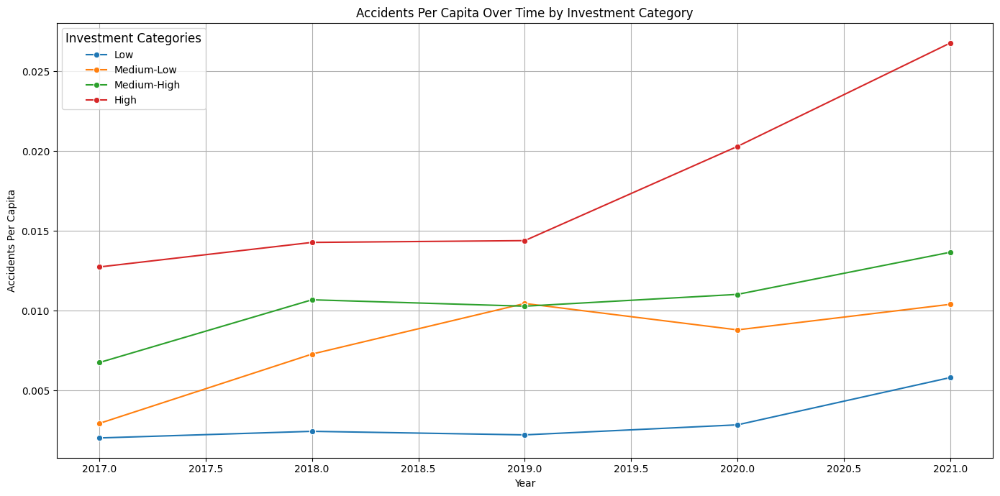

In [26]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Calculate Investment Quartiles to Categorize States
if 'Expenditures(M)' in merged_df_updated.columns:
    investment_summary = merged_df_updated.groupby('State_x')['Expenditures(M)'].median().reset_index()
    investment_summary['investment_category'] = pd.qcut(investment_summary['Expenditures(M)'], q=4, labels=['Low', 'Medium-Low', 'Medium-High', 'High'])

    # Step 2: Drop existing investment_category column from merged_df_updated, if it exists
    if 'investment_category' in merged_df_updated.columns:
        merged_df_updated.drop(columns=['investment_category'], inplace=True)

    # Step 3: Merge investment category back to merged_df_updated
    merged_df_updated = merged_df_updated.merge(investment_summary[['State_x', 'investment_category']], on='State_x', how='left')

    # Step 4: Aggregate accident data by year and investment category
    investment_trends = merged_df_updated.groupby(['Year', 'investment_category'], observed=False).agg(
    total_accidents=('Severity', 'size'),
    mean_population=('Population', 'mean')
    ).reset_index()


    # Step 5: Calculate accidents per capita
    investment_trends['accidents_per_capita'] = investment_trends['total_accidents'] / investment_trends['mean_population']

    # Step 6: Plot the trends with expanded legend
    plt.figure(figsize=(14, 7))
    sns.lineplot(x='Year', y='accidents_per_capita', hue='investment_category', data=investment_trends, marker='o')

    # Set title and labels
    plt.title('Accidents Per Capita Over Time by Investment Category')
    plt.xlabel('Year')
    plt.ylabel('Accidents Per Capita')
    plt.legend(title='Investment Categories', fontsize=10, title_fontsize=12)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

else:
    raise KeyError("The column 'Expenditures(M)' does not exist in merged_df_updated.")


In [27]:
# Calculate the percentage of rows remaining after data cleaning
remaining_rows = len(merged_df_updated) / len(sample_data) * 100
remaining_rows_count = len(merged_df_updated)
print(f"Percentage of rows remaining from the original sampled set: {remaining_rows:.2f}%")
print(f"Number of rows remaining: {remaining_rows_count}")

Percentage of rows remaining from the original sampled set: 71.80%
Number of rows remaining: 332197


Generating `total_accidents` column from existing data.
Replacing `mean_population` with `Population` for analysis.
Correlation Matrix:
                 Expenditures(M)  total_accidents  Population
Expenditures(M)         1.000000         0.842558    0.370533
total_accidents         0.842558         1.000000    0.351810
Population              0.370533         0.351810    1.000000

P-Value Matrix:
                Expenditures(M) total_accidents Population
Expenditures(M)             NaN             0.0        0.0
Population                  0.0             0.0        NaN
total_accidents             0.0             NaN        0.0


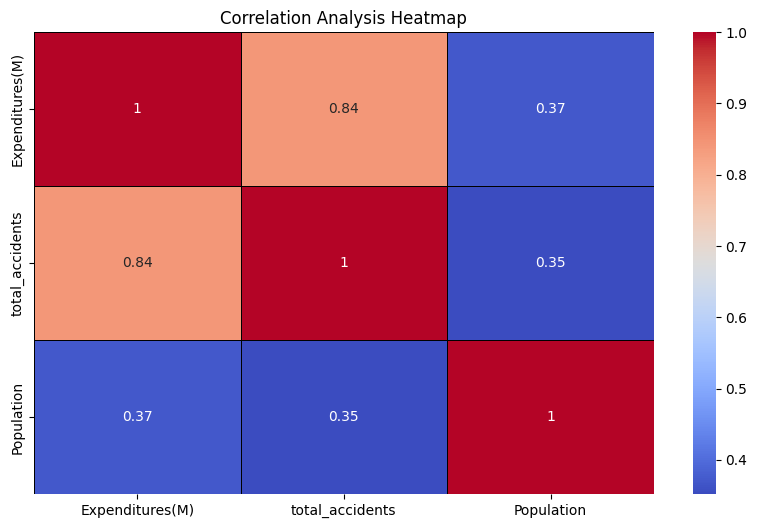

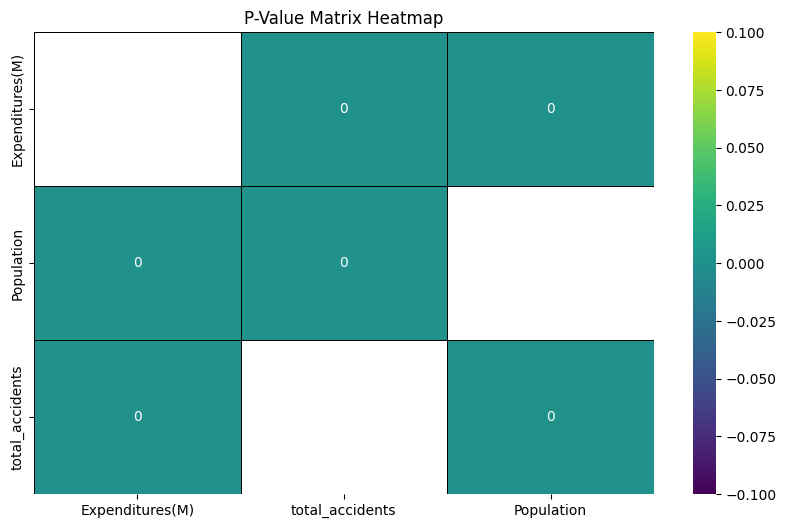

In [33]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

# Assuming the dataset is already loaded as `merged_df_updated`
# Check for available columns and adjust correlation_columns accordingly
correlation_columns = ['Expenditures(M)', 'total_accidents', 'mean_population']

# Generate `total_accidents` if not present
if 'total_accidents' not in merged_df_updated.columns:
    print("Generating `total_accidents` column from existing data.")
    merged_df_updated['total_accidents'] = merged_df_updated.groupby(['State_Full', 'Year'])['ID'].transform('count')

# Use 'Population' instead of 'mean_population' if 'mean_population' is not found
if 'mean_population' not in merged_df_updated.columns:
    print("Replacing `mean_population` with `Population` for analysis.")
    correlation_columns = ['Expenditures(M)', 'total_accidents', 'Population']

# Verify if columns exist in the dataframe
missing_cols = [col for col in correlation_columns if col not in merged_df_updated.columns]
if missing_cols:
    print(f"Missing Columns: {missing_cols}")
else:
    # Drop rows with missing values in the selected columns
    filtered_df = merged_df_updated[correlation_columns].dropna()

    # Ensure the selected columns are numeric
    for col in correlation_columns:
        filtered_df[col] = pd.to_numeric(filtered_df[col], errors='coerce')

    # Step 1: Calculate the correlation matrix
    correlation_matrix = filtered_df.corr()
    print("Correlation Matrix:")
    print(correlation_matrix)

    # Step 2: Calculate the p-value matrix
    def calculate_p_values(df):
        df_cols = pd.DataFrame(columns=df.columns)
        p_values = df_cols.transpose().join(df_cols, how='outer')

        for r in df.columns:
            for c in df.columns:
                if r == c:
                    p_values.loc[r, c] = np.nan
                else:
                    try:
                        _, p_value = pearsonr(df[r], df[c])
                        p_values.loc[r, c] = round(p_value, 4)
                    except Exception as e:
                        print(f"Error calculating p-value for {r} vs {c}: {e}")
                        p_values.loc[r, c] = np.nan
        return p_values

    p_values = calculate_p_values(filtered_df)
    print("\nP-Value Matrix:")
    print(p_values)

    # Step 3: Plot the correlation matrix as a heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, linecolor='black')
    plt.title('Correlation Analysis Heatmap')
    plt.show()

    # Step 4: Plot the p-value matrix as a heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(p_values.astype(float), annot=True, cmap='viridis', linewidths=0.5, linecolor='black')
    plt.title('P-Value Matrix Heatmap')
    plt.show()


# 4. Preprocessing

# **DONT USE ANYTHING PAST THIS. OLD CODE**

Spatial Analysis (Sub Question 2: Geographic Distribution)

Positive vs. Negative Correlation: You’ll see which weather factors are positively or negatively correlated with accident severity. For example, higher precipitation might correlate with higher severity, while higher visibility might correlate with lower severity.

Strength of Correlations: The heatmap helps quickly identify which factors have stronger correlations with severity and among each other.

Environmental Factors (Sub Question 2: Impact of Weather Conditions)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Extended mapping for the remaining unmapped weather conditions
weather_group_map = {
    # Clear weather
    'Clear': 'Clear', 'Fair': 'Clear', 'Fair / Windy': 'Clear',

    # Cloudy weather
    'Cloudy': 'Cloudy', 'Partly Cloudy': 'Cloudy', 'Mostly Cloudy': 'Cloudy', 'Overcast': 'Cloudy',
    'Scattered Clouds': 'Cloudy', 'Cloudy / Windy': 'Cloudy', 'Partly Cloudy / Windy': 'Cloudy', 'Mostly Cloudy / Windy': 'Cloudy',

    # Rainy weather
    'Light Rain': 'Rain', 'Heavy Rain': 'Rain', 'Rain': 'Rain', 'Drizzle': 'Rain', 'Light Drizzle': 'Rain',
    'Heavy Drizzle': 'Rain', 'Rain Shower': 'Rain', 'Showers in the Vicinity': 'Rain', 'Heavy Rain / Windy': 'Rain',
    'Rain / Windy': 'Rain', 'Light Rain Showers': 'Rain', 'Light Rain Shower': 'Rain', 'Rain Showers': 'Rain',
    'Light Rain / Windy': 'Rain', 'Light Drizzle / Windy': 'Rain', 'Drizzle and Fog': 'Rain', 'Light Rain Shower / Windy': 'Rain',
    'Drizzle / Windy': 'Rain',  # Added condition

    # Thunderstorms
    'Thunderstorm': 'Thunderstorm', 'Thunder': 'Thunderstorm', 'T-Storm': 'Thunderstorm',
    'Light Thunderstorms and Rain': 'Thunderstorm', 'Heavy T-Storm': 'Thunderstorm', 'T-Storm / Windy': 'Thunderstorm',
    'Thunderstorms and Rain': 'Thunderstorm', 'Light Rain with Thunder': 'Thunderstorm', 'Thunder / Windy': 'Thunderstorm',
    'Heavy T-Storm / Windy': 'Thunderstorm', 'Heavy Thunderstorms and Rain': 'Thunderstorm', 'Thunder in the Vicinity': 'Thunderstorm',
    'Thunder / Wintry Mix': 'Thunderstorm', 'Light Thunderstorms and Snow': 'Thunderstorm',

    # Snowy weather
    'Snow': 'Snow', 'Light Snow': 'Snow', 'Heavy Snow': 'Snow', 'Snow and Sleet': 'Snow', 'Blowing Snow': 'Snow',
    'Heavy Snow / Windy': 'Snow', 'Snow / Windy': 'Snow', 'Blowing Snow / Windy': 'Snow',
    'Light Snow Showers': 'Snow', 'Light Snow Shower': 'Snow', 'Snow and Thunder': 'Snow', 'Light Snow and Sleet': 'Snow',
    'Light Snow / Windy': 'Snow', 'Light Snow with Thunder': 'Snow', 'Light Snow and Sleet / Windy': 'Snow',
    'Snow and Sleet / Windy': 'Snow', 'Light Blowing Snow': 'Snow', 'Drifting Snow / Windy': 'Snow', 'Light Snow Grains': 'Snow',
    'Snow Grains': 'Snow',  # Added condition

    # Fog and mist
    'Fog': 'Fog', 'Mist': 'Fog', 'Haze': 'Fog', 'Shallow Fog': 'Fog', 'Fog / Windy': 'Fog', 'Haze / Windy': 'Fog',
    'Mist / Windy': 'Fog', 'Light Haze': 'Fog', 'Patches of Fog': 'Fog', 'Partial Fog': 'Fog', 'Partial Fog / Windy': 'Fog',
    'Light Freezing Fog': 'Fog',  # Added condition

    # Winter weather and wintry mix
    'Wintry Mix': 'Winter Weather', 'Sleet': 'Winter Weather', 'Freezing Rain': 'Winter Weather',
    'Light Freezing Rain': 'Winter Weather', 'Heavy Freezing Rain': 'Winter Weather',
    'Wintry Mix / Windy': 'Winter Weather', 'Sleet / Windy': 'Winter Weather', 'Light Sleet': 'Winter Weather',
    'Light Freezing Rain / Windy': 'Winter Weather', 'Light Ice Pellets': 'Winter Weather', 'Light Freezing Drizzle': 'Winter Weather',
    'Freezing Drizzle': 'Winter Weather', 'Heavy Freezing Drizzle': 'Winter Weather', 'Ice Pellets': 'Winter Weather',
    'Small Hail': 'Winter Weather', 'Hail': 'Winter Weather', 'Light Hail': 'Winter Weather',  # Added condition

    # Other uncommon conditions
    'N/A Precipitation': 'Other', 'Volcanic Ash': 'Other', 'Sand': 'Other', 'Sand / Dust Whirlwinds': 'Other',
    'Widespread Dust': 'Other', 'Widespread Dust / Windy': 'Other', 'Smoke': 'Other', 'Smoke / Windy': 'Other',
    'Squalls': 'Other', 'Squalls / Windy': 'Other', 'Funnel Cloud': 'Other', 'Low Drifting Snow': 'Other',
    'Blowing Dust': 'Other', 'Blowing Dust / Windy': 'Other', 'Heavy Sleet': 'Other', 'Thunder and Hail': 'Other',
}

# Step 1: Apply the weather group mapping to create a new grouped column
data_clean['Weather_Condition_Grouped'] = data_clean['Weather_Condition'].replace(weather_group_map)

# Handle any weather conditions that were not mapped by grouping them as 'Other'
data_clean['Weather_Condition_Grouped'] = data_clean['Weather_Condition_Grouped'].fillna('Other')

# Step 2: Get the counts for each grouped weather condition
weather_condition_grouped_counts = data_clean['Weather_Condition_Grouped'].value_counts()

# Step 3: Plot the bar chart using the grouped weather conditions
plt.figure(figsize=(10, 6))

# Flip the axes by switching x and y in sns.barplot
sns.barplot(y=weather_condition_grouped_counts.index, x=weather_condition_grouped_counts.values, palette='Set2')

# Add title and labels
plt.title('Accidents per Grouped Weather Condition', fontsize=14)
plt.xlabel('Number of Accidents', fontsize=12)
plt.ylabel('Weather Condition', fontsize=12)

plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn style for better aesthetics
sns.set_style('whitegrid')

# List of relevant road feature columns
road_features = ['Amenity', 'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit',
                 'Railway', 'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal']

# Initialize an empty dictionary to store counts
road_feature_counts = {}

# Count accidents where each feature is present (True) vs absent (False)
for feature in road_features:
    road_feature_counts[feature] = data_clean[feature].value_counts()

# Create a DataFrame from the dictionary for easier plotting
road_feature_df = pd.DataFrame(road_feature_counts)

# Plot the data using a stacked bar plot with a customized color palette
plt.figure(figsize=(12, 7))
road_feature_df.T.plot(kind='bar', stacked=True, figsize=(12, 7), color=['#FF9999', '#66B2FF'])

# Add title, labels, and legend
plt.title('Accidents by Road Feature Presence', fontsize=16, fontweight='bold')
plt.xlabel('Road Feature', fontsize=14)
plt.ylabel('Number of Accidents', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.legend(['Absent', 'Present'], title='Feature Present', fontsize=12)

# Add data labels to each bar for better readability
for container in plt.gca().containers:
    plt.gca().bar_label(container, fmt='%d', label_type='center', fontsize=10, padding=3)

plt.tight_layout()
plt.show()



In [ ]:
# Accident Severity by Road Feature
sns.set_style('whitegrid')

severity_by_road_feature = data_clean.groupby(['Severity'])[road_features].sum()

# Transpose the data for plotting
severity_by_road_feature_T = severity_by_road_feature.T

# Plot the severity distribution for each road feature as grouped bars
plt.figure(figsize=(14, 8))
severity_by_road_feature_T.plot(kind='bar', figsize=(14, 8),
                                color=sns.color_palette('coolwarm', n_colors=len(severity_by_road_feature_T.columns)))

# Add title, labels, and legend
plt.title('Accident Severity by Road Feature', fontsize=16, fontweight='bold')
plt.xlabel('Road Feature', fontsize=14)
plt.ylabel('Number of Accidents', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Severity', fontsize=12)

# Adjust the layout for better readability
plt.tight_layout()

# Show the plot
plt.show()


Correlation Analysis

In [ ]:
# Correlation Heatmap for Numerical Features and Severity
# Select the numerical columns, including 'Severity'
numerical_columns = ['Severity', 'Temperature(F)', 'Wind_Speed(mph)', 'Visibility(mi)',
                     'Humidity(%)', 'Pressure(in)', 'Precipitation(in)']

# Filter the dataset to only include those numerical columns
numerical_data = data_clean[numerical_columns]

# Compute the correlation matrix
correlation_matrix = numerical_data.corr()

# Plot the correlation heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)

# Add title
plt.title('Correlation Heatmap: Numerical Features and Severity', fontsize=16, fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

Outlier Dectection and Handling

Feature Imprtance for Prediction (Sub Question 3: Machine Learning)

Predictive Modeling (Sub-Question 3: Predicting Accident Severity)

In [ ]:
# Heatmap with weight based on accident severity
# Create a base map centered at the average location
accident_locations = data_clean[['Start_Lat', 'Start_Lng', 'Severity']].dropna()

# Initialize the map at the mean accident location
map = folium.Map(location=[accident_locations['Start_Lat'].mean(), accident_locations['Start_Lng'].mean()], zoom_start=5)

# Prepare data for the heatmap using accident severity as a weight
heat_data = [[row['Start_Lat'], row['Start_Lng'], row['Severity']] for index, row in accident_locations.iterrows()]

# Add a heatmap layer, using severity to weigh the intensity of each point
HeatMap(heat_data, radius=8, max_zoom=13).add_to(map)

# Show the map
map


This second heatmap not only helps **identify high-risk** areas but also where both frequency and severity of accidents are factors.